# Matplotlib.pyplot 

In [1]:
# Esta celda da el estilo al notebook
from IPython.core.display import HTML
css_style = 'style_1.css'
css_file = css_style
HTML(open(css_file, "r").read())

Matplotlib is a collection of command style functions that function similar to MATLAB. While this is gnerally less flexible than the object oriented API, a majority of function calls are shared.

In [2]:
import numpy as np
import matplotlib.pyplot as plt

## 1. Line plots

The first thing is the most basic. How to plot a simple line. The most basic one is presented:

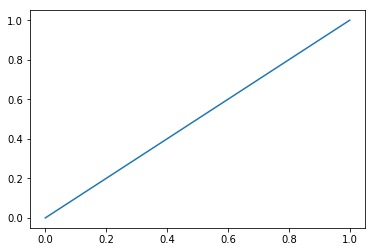

In [3]:
x = np.linspace(0,1,3)
y = np.linspace(0,1,3)
plt.plot(x,y)
plt.show()

Pretty straightforward. This is a bit of a barebone figure. We can add more things using keywords, of course:

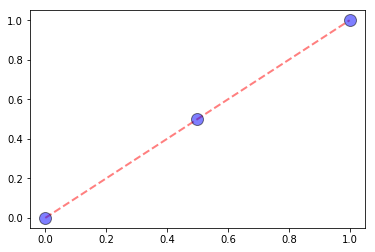

In [4]:
x = np.linspace(0,1,3)
y = np.linspace(0,1,3)
plt.plot(x,y,
         #Line kwargs
         color = 'red', linestyle = '--', linewidth = 2, alpha = 0.5,
         # Marker kwargs
         marker = 'o', markerfacecolor = 'blue', markeredgecolor = 'black',
         markersize = 12)
plt.show()

These are however all keywords associated to the plt.plot object line. We can also add variety to the figure.

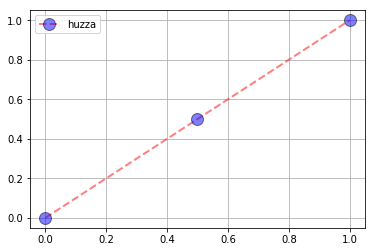

In [5]:
x = np.linspace(0,1,3)
y = np.linspace(0,1,3)
plt.plot(x,y,
         #Line kwargs
         color = 'red', linestyle = '--', linewidth = 2, alpha = 0.5,
         # Marker kwargs
         marker = 'o', markerfacecolor = 'blue', markeredgecolor = 'black',
         markersize = 12)
plt.grid(alpha = 1)
plt.legend(['huzza'])
plt.show()

We'll see more of these below.

## 2. Scatter plots

These are similar to th eline plots, however, they represent points.

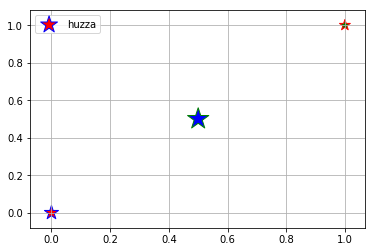

In [6]:
x = np.linspace(0,1,3)
y = np.linspace(0,1,3)
plt.scatter(x,y, color = ['red', 'blue', 'green'], s = [220, 500, 130],
           marker = '*', edgecolor = ['blue', 'green', 'red'])
plt.grid(alpha = 1)
plt.legend(['huzza'])
plt.show()

## 3. Histograms

Histograms can be as well plotted pretty easily.

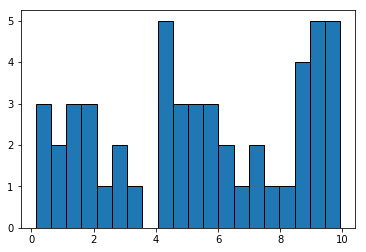

In [7]:
x = 10*np.random.rand(50,1)
plt.hist(x, bins = 20, edgecolor = 'black')
plt.show()

## 4. Multiplot

Of course, it is possible to plot multiple things in the same figure. Let's give a simple example. We remember that everything here is an object, which will help understanding what we are doing. The `plt.getp(object)` returns the properties of any object created.

We start by plotting everything into the same axes:

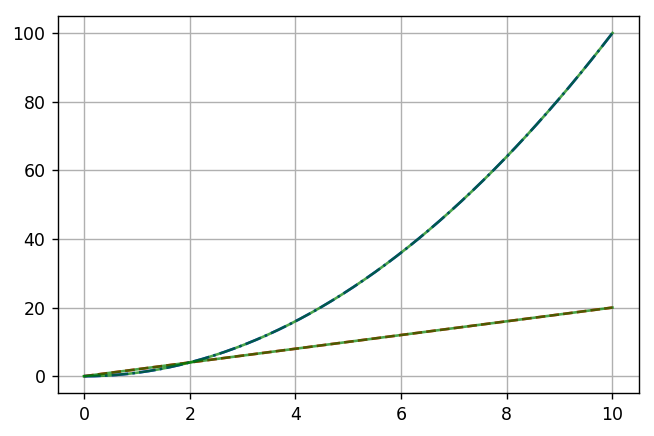

In [8]:
x = np.linspace(0,10)
y = lambda x: 2*x
z = lambda x: x**2

## We create a figure and axes
fig = plt.figure(dpi = 125)
ax = plt.axes()

## We create the plots. We can use both plt.plot or ax.plot.
plot1 = ax.plot(x,y(x), ls = '--', c = 'r')
plot2 = plt.plot(x,z(x), ls = '-.', c = 'b')
plot3 = ax.plot(np.column_stack([x,x]), np.column_stack([y(x),z(x)]), 
                color = 'green', alpha = 0.7)

## This puts pretty grid
plt.grid()

## This shows the figure
plt.show()

We can create different axes objects in the same figure:

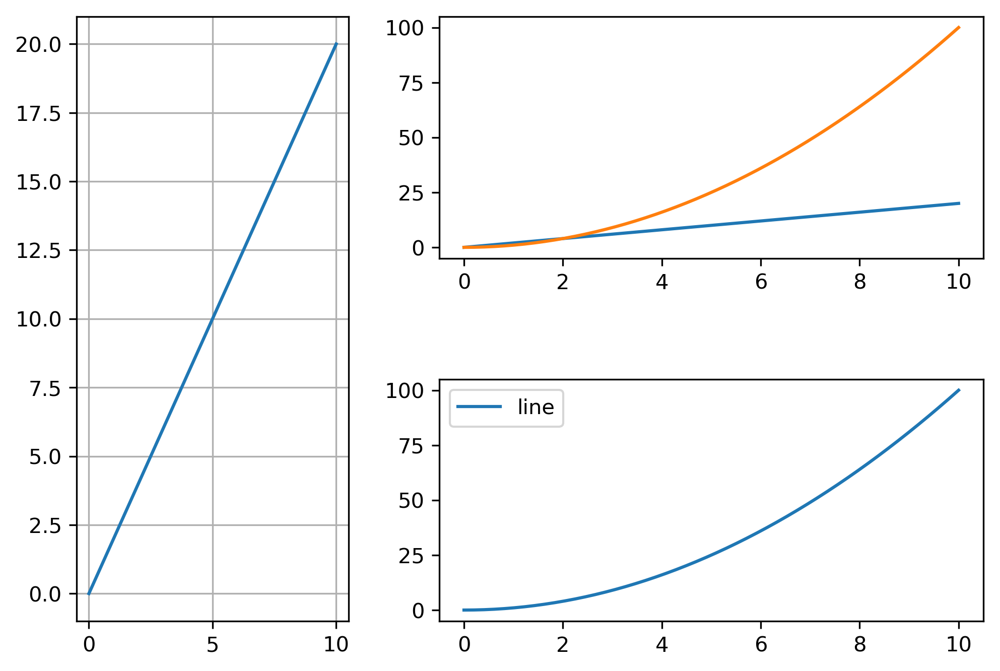

In [9]:
x = np.linspace(0,10)
y = lambda x: 2*x
z = lambda x: x**2

## We create a figure and axes in normalized dimensions
fig = plt.figure(dpi = 300)
#plt.box()
ax1 = plt.axes((0,0,0.3,1))
ax2 = plt.axes((0.4,0,0.6,0.4))
ax3 = plt.axes((0.4,0.6, 0.6, 0.4))

## Now if we plot with plt. it will plot on the last axes object, so we use
## ax.plot instead
ax1.plot(x,y(x))
ax2.plot(x,z(x), label = 'line')
ax3.plot(x,y(x))
ax3.plot(x,z(x))

## The attributes the same for each one
ax1.grid()
ax2.legend()

## Showing
plt.savefig(r'Material_Matplotlib\prueba.png', 
            bbox_inches = 'tight'
           )
plt.show()

Another equivalent option is using subplots:

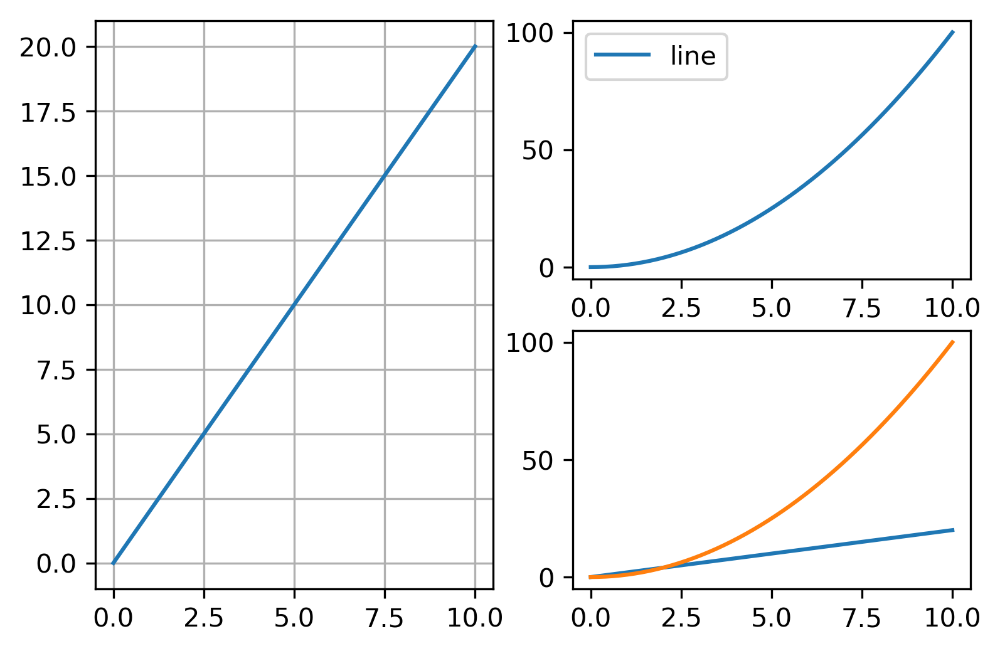

In [10]:
x = np.linspace(0,10)
y = lambda x: 2*x
z = lambda x: x**2

## We create a figure and axes in normalized dimensions
fig = plt.figure(dpi = 300)

plt.subplot(2,2,(1,3))
plt.plot(x,y(x))
plt.grid()
plt.subplot(2,2,2)
plt.plot(x,z(x), label = 'line')
plt.legend()
plt.subplot(2,2,4)
plt.plot(x,y(x))
plt.plot(x,z(x))



## Showing
plt.savefig(r'Material_Matplotlib\prueba.png', 
            bbox_inches = 'tight'
           )
plt.show()

## 5. Artists

In the matplotlib API, there are three layers:

- `matplotlib.backend_bases.FigureCanvas`: The area where the figure is drawn
- `matplotlib.backend_bases.Rendered`: The object that knows how to draw in the `FigureCanvas`
- `matplotlib.artist.Artist`: The object that knows how to use a renderer to paint onto the canvas

There are two main types of `Artists`. The primitives, which are the standard graphical objects (`Line2D, Rectangle, Text, AxesImage,...`) and the containers (`Axis, Axes, Figure`)

As an example of what we could do with this, let us see the following:

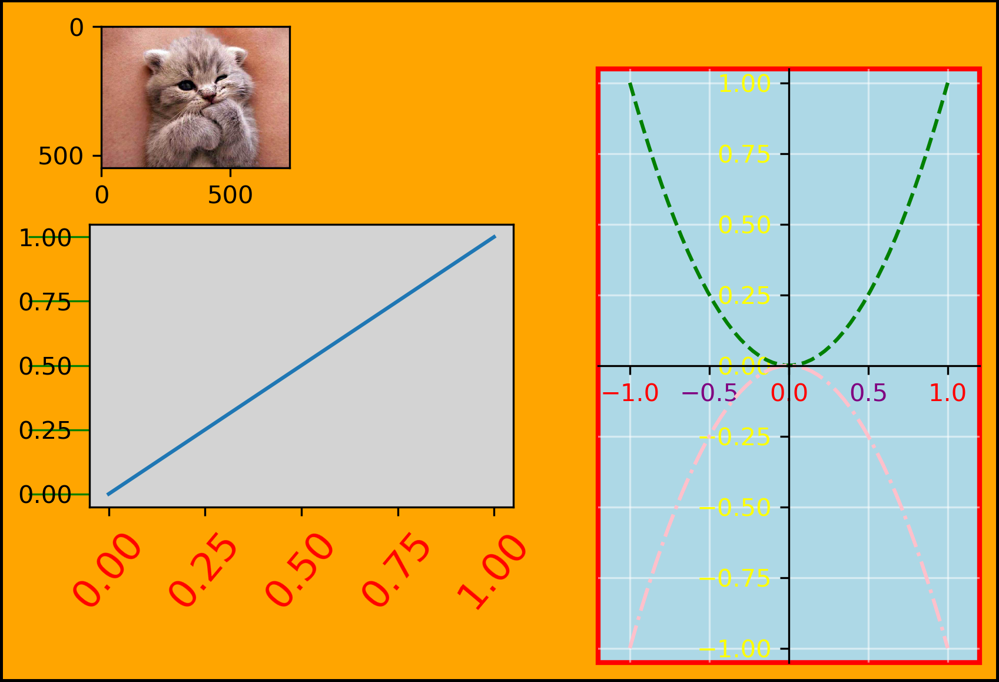

In [11]:
## We create the figure and a patch
fig = plt.figure(dpi = 300)
rect = fig.patch
rect.set_facecolor('orange')
rect.set_edgecolor('black')
rect.set_linewidth(2)

## We create axes.
ax1 = fig.add_axes([0.1, 0.3, 0.4, 0.4])
ax2 = fig.add_axes([0.58, 0.08, 0.36, 1-0.08*2])
ax3 = fig.add_axes([0.1, 0.78, 0.2, 0.20])
rect = ax1.patch
rect2 = ax2.patch
rect.set_facecolor('lightgrey')
rect2.set_facecolor('lightblue')
rect2.set_edgecolor('red')
rect2.set_linewidth(2)
rect2.set_fill(True)


## AXES 1
## We change the labels of the xaxis
for label in ax1.xaxis.get_ticklabels():
    label.set_color('red')
    label.set_rotation('50')
    label.set_fontsize(16)
    
## We change the lines of the yaxis
for line in ax1.yaxis.get_ticklines():
    line.set_color('green')
    line.set_markersize(25)

ax1.plot([0,1],[0,1])
    
    
## AXES 2
## We remove the right and top lines
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
## We reposition the left and bottom to the enter
ax2.spines['left'].set_position('center')
ax2.spines['bottom'].set_position('center')
## We change the x and y ticks and labels to adjust the grid
ax2.set_xlim([-1.2,1.2])
ax2.set_ylim([-1.05, 1.05])
ax2.grid(True, color = 'white', alpha = 0.5)
## We change the labels
for number,label in enumerate(ax2.xaxis.get_ticklabels()):
    if (number+1)%2 == 0:
        label.set_color('red')
    else:
        label.set_color('purple')
[label.set_color('yellow') for label in ax2.yaxis.get_ticklabels()]
## We plot
x = np.linspace(-1, 1)
ax2.plot(x, x**2, '--', color = 'green')
ax2.plot(x, -x**2, '-.', color = 'pink')

## AXES 3
img = plt.imread(r'Material_Matplotlib\cute_kitty.jpg')
ax3.imshow(img)

## We show the plot
plt.savefig(r'Material_Matplotlib\prueba.png', facecolor = fig.get_facecolor(), 
            edgecolor = fig.get_edgecolor())
plt.show()

## 6. Animations

The easiest way to make an animation is using one of the `Animation` classes

In [12]:
import matplotlib.animation as animation
from IPython.display import HTML

### 6.1 FuncAnimation

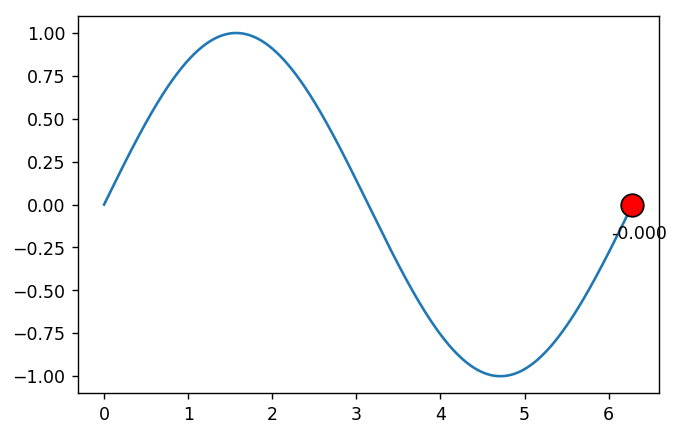

In [13]:
t = np.arange(0, 2*np.pi, 0.001)
s = np.sin(t)


## Creating the figure
fig = plt.figure( dpi = 125)
ax = plt.gca()
line = plt.plot(t,s)

## We create the thing that we are gonna move
redDot, = plt.plot(0,np.sin(0),
                 markerfacecolor = 'red', marker = 'o',
                 markeredgecolor = 'black', markersize = 13)
text = plt.text(0-0.25, np.sin(0)-0.20, '{0:.3f}'.format(np.sin(0)))

## We define the animate function
def animate(i):
    redDot.set_data(i, np.sin(i))
    text.set_text('{0:.3f}'.format(np.sin(i)))
    text.set_position((i - 0.25, np.sin(i) - 0.2))
    return redDot, text # It requires an iterable

## We create the animation using the animate() function
myAnimation = animation.FuncAnimation(fig, animate, 
                                     frames = np.linspace(0, 2*np.pi, 400),
                                     interval = 15, blit = True, repeat = False)
myAnimation.save(r'Material_Matplotlib\uhm.mp4')
## Plotting
#HTML(myAnimation.to_html5_video())
HTML(myAnimation.to_jshtml())

There are more complicated things that can be done, of course:

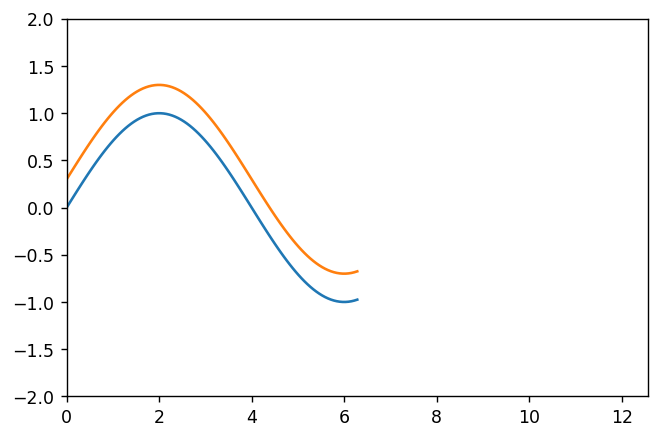

In [14]:
field = np.linspace(0,100)
sinusoidal_wave = []

fig = plt.figure(dpi = 125)
ax = plt.gca()
line, = ax.plot([],[])
line2, = ax.plot([],[])
ax.set_xlim([0,2*2*np.pi])
ax.set_ylim([-2,2])
d = 0.3
def animate(i):
    x = np.linspace(0, 2*np.pi, 100)
    y = np.sin(np.pi*(x+i)*1/4)
    line.set_data(x,y)
    line2.set_data(x,y+d)
    return line,line2

myAnimation = animation.FuncAnimation(fig, animate, 
                                     frames = np.linspace(0,8,200),
                                     interval = 40, blit = True, repeat = False)

HTML(myAnimation.to_jshtml())

And of course, even more dificult stuff.

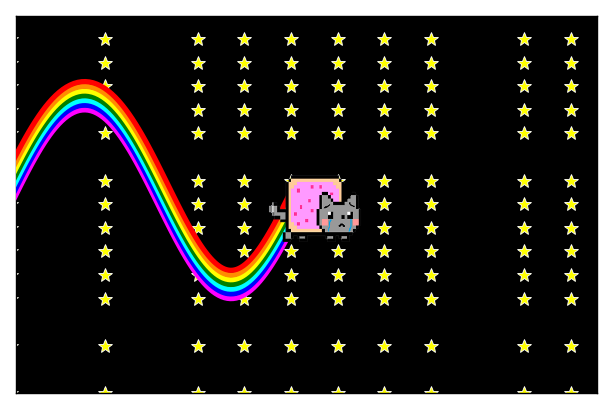

In [15]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

## We create a normal vector function that returns the displacement on x and y
def normal(x):
    return -np.cos(x)/np.sqrt(np.cos(x)**2 + 1), 1/np.sqrt(np.cos(x)**2 + 1)

## We read the image
img = plt.imread(r'Material_Matplotlib\nyantransparent.png')
## Creating the figure
fig = plt.figure(dpi = 125)
ax = plt.gca()
rect = ax.patch
rect.set_color('black')
rect.set_alpha(1)
ax.set_xlim([0.1,2*2*np.pi])
ax.set_ylim([-2,2])
ax.set_yticklabels([]); ax.set_yticks([])
ax.set_xticklabels([]); ax.set_xticks([])


## Creating the color dictionary
colors = {}
color_list = ['magenta', 'blue', 'cyan', 'green', 'yellow', 'darkorange', 'red']
for i in color_list:
    colors[i], = ax.plot([],[], lw = 3, zorder = 8)
    
## We create the cat
cat_width = 2; cat_height = 0.8;
position = (5.5, 0)
cat = ax.imshow(img, aspect = 'auto', 
                extent = [position[0],position[0]+ cat_width,position[1],
                          position[1] + cat_height], zorder = 10)

## We create the stars
starsx = np.arange(0, 14, 1)
starsy = np.arange(-2, 2, 0.25)
for i in range(3):
    number = np.random.randint(low = 0, high = min(starsx.shape[0], starsy.shape[0]))
    starsx = np.delete(starsx, number)
    starsy = np.delete(starsy, number)
starsxx,starsyy = np.meshgrid(starsx, starsy)


ax.plot(starsxx, starsyy, marker = '*',
        markeredgecolor = 'white', markersize = 8,
        markeredgewidth = 0.5,color = 'yellow', ls = "None")

## We define the animation
def animate(i):
    list_return = []
    iteration = 0
    xcat = np.linspace(0, 2*np.pi, 100)
    ycat = np.sin(xcat+i)
    
    for n,j in enumerate(colors):
        x = np.linspace(0, 2*np.pi, 100)
        y = np.sin(x+i)
        colors[j].set_data(x+normal(x+i)[0]*iteration,y+normal(x+i)[1]*iteration)
        colors[j].set_color(j)
        iteration += 0.05
        list_return.append(colors[j])
    cat.set_extent([position[0], position[0] + cat_width, 
                    ycat[-1]-0.45, ycat[-1]-0.45+cat_height])
    list_return.append(cat)
    return list_return 

myAnimation = animation.FuncAnimation(fig, animate, 
                                     frames = np.linspace(0,2*np.pi,200),
                                     interval = 10, blit = True, repeat = False)

myAnimation.save(r'Material_Matplotlib\nyan.mp4')
HTML(myAnimation.to_jshtml())  